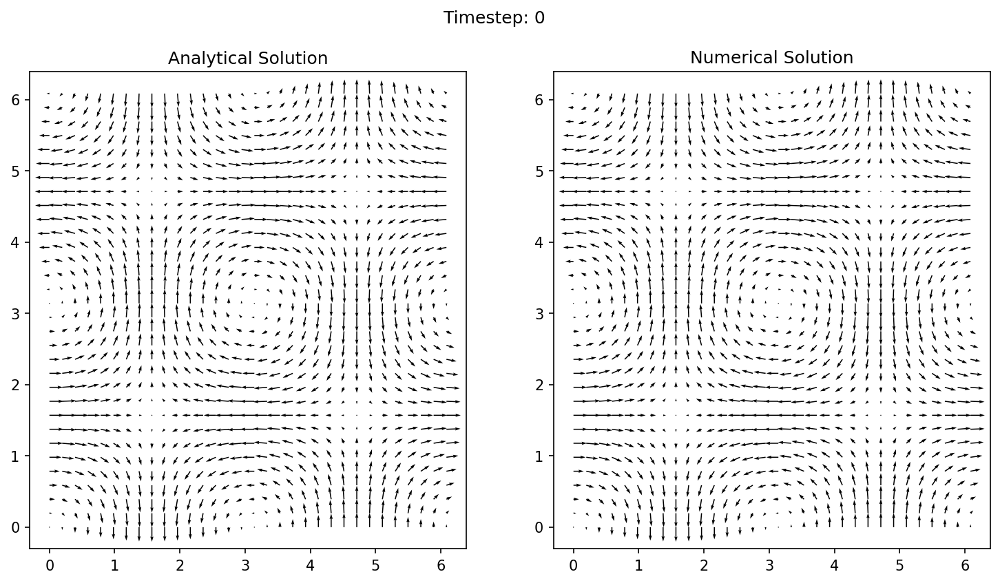

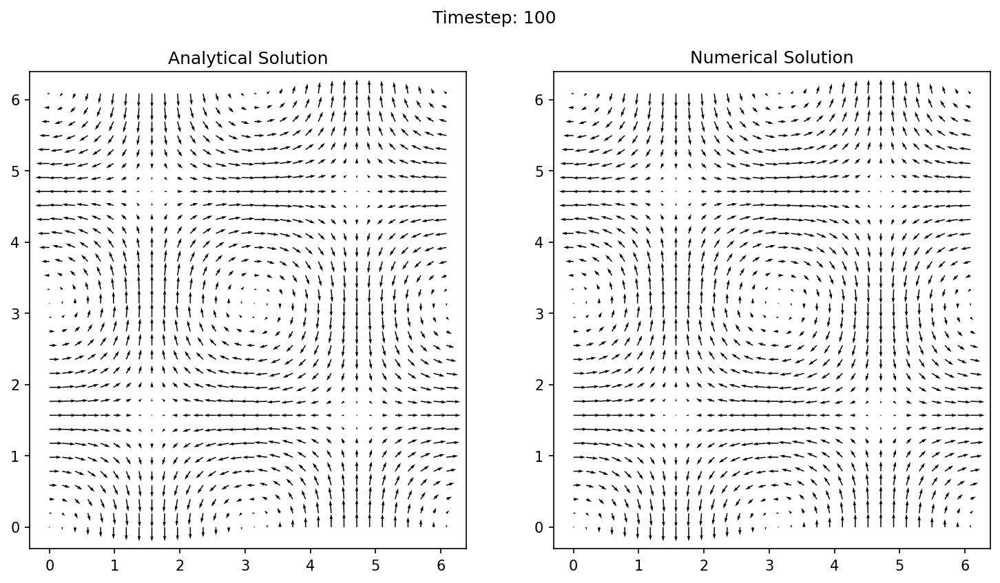

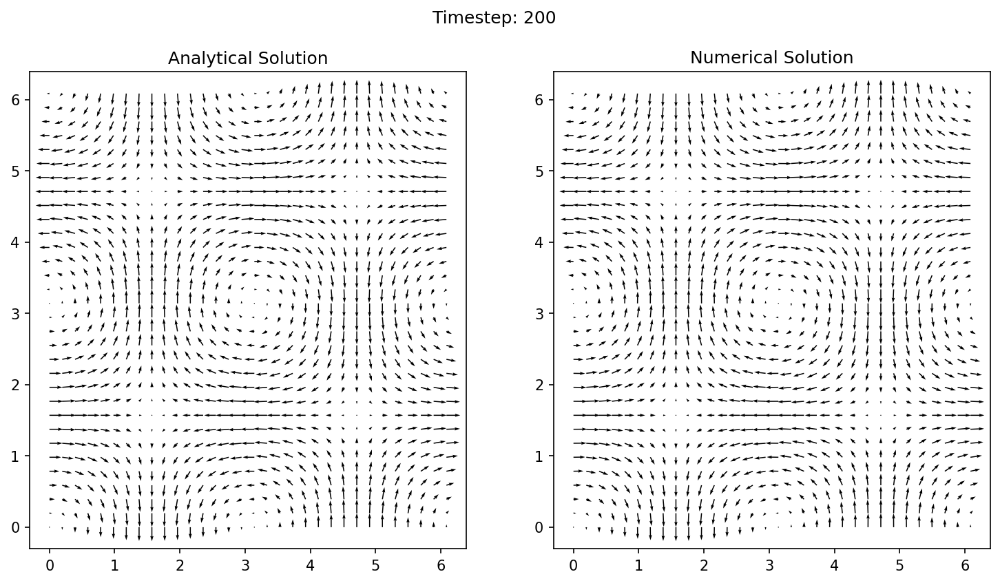

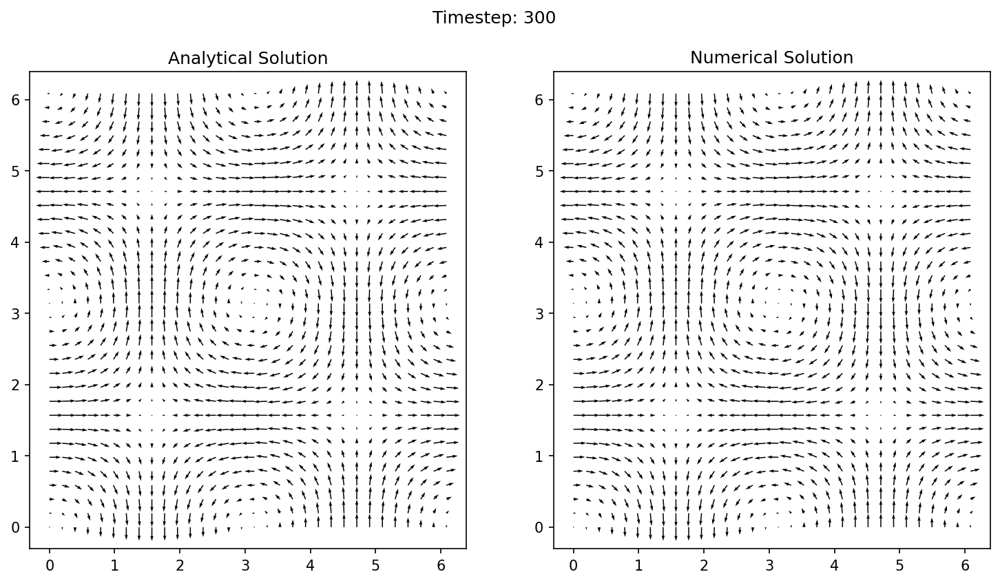

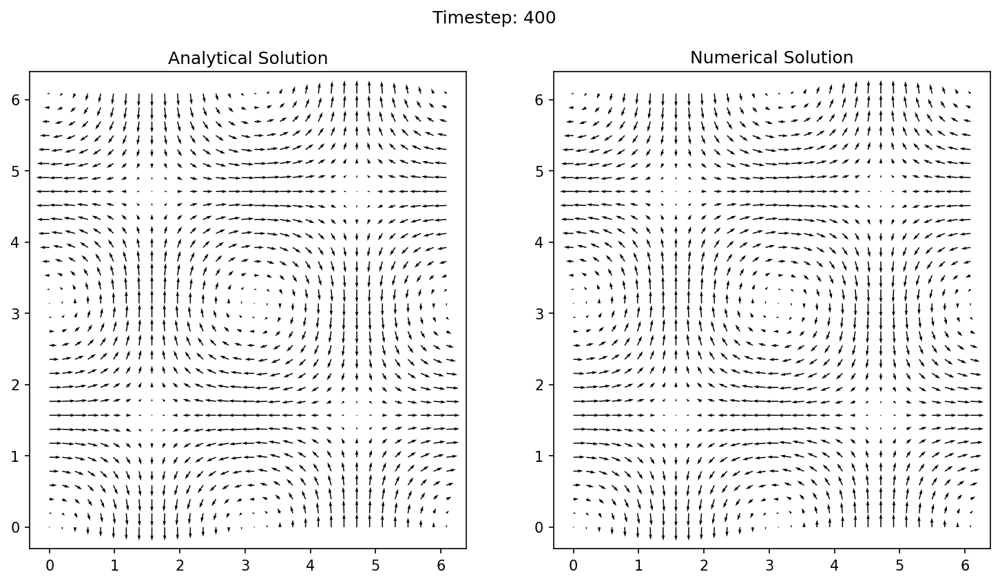

...

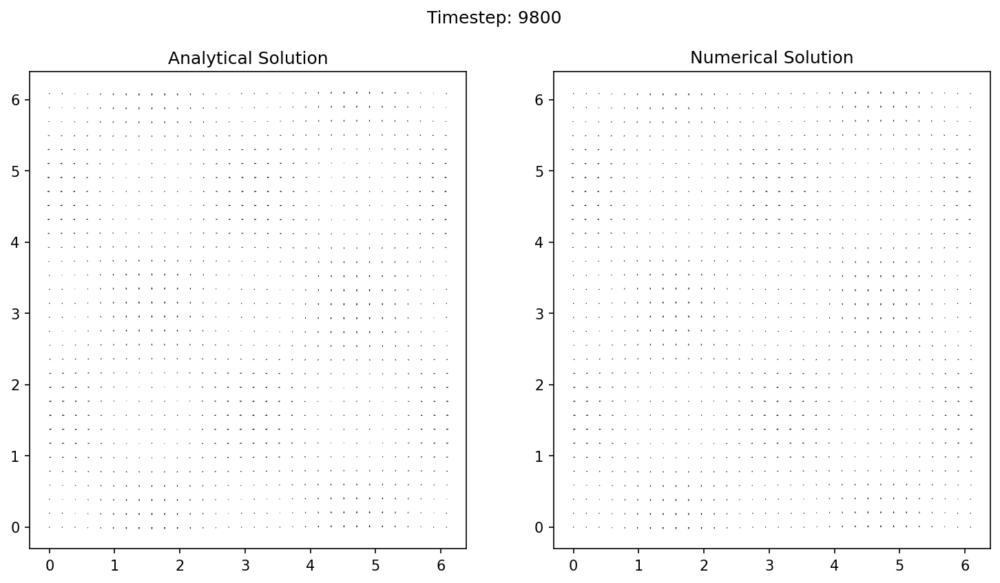

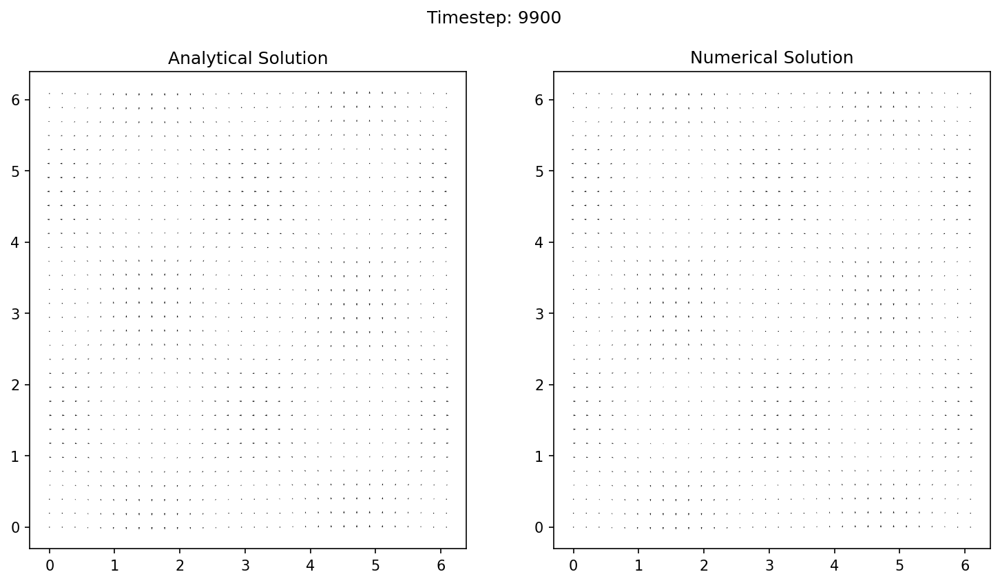

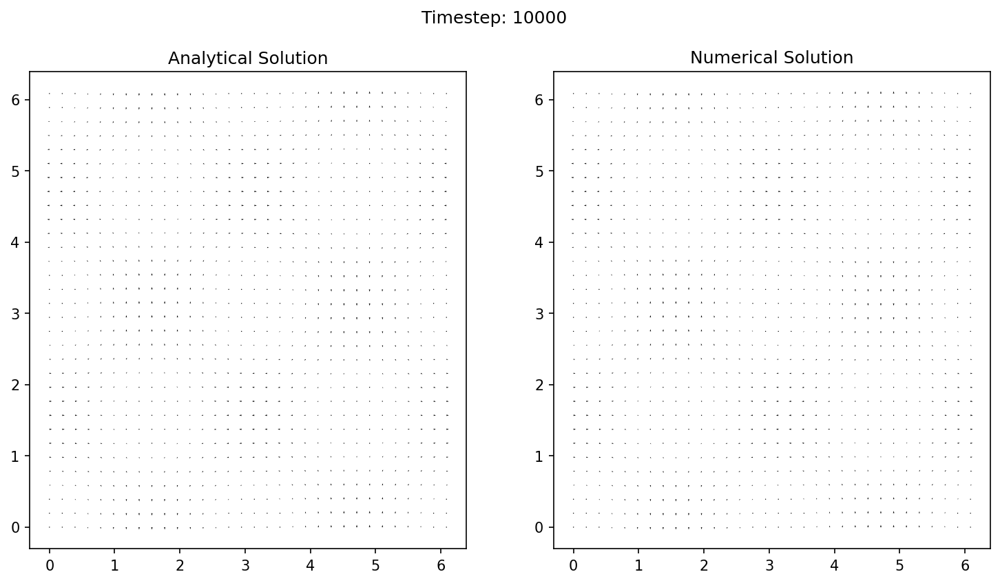

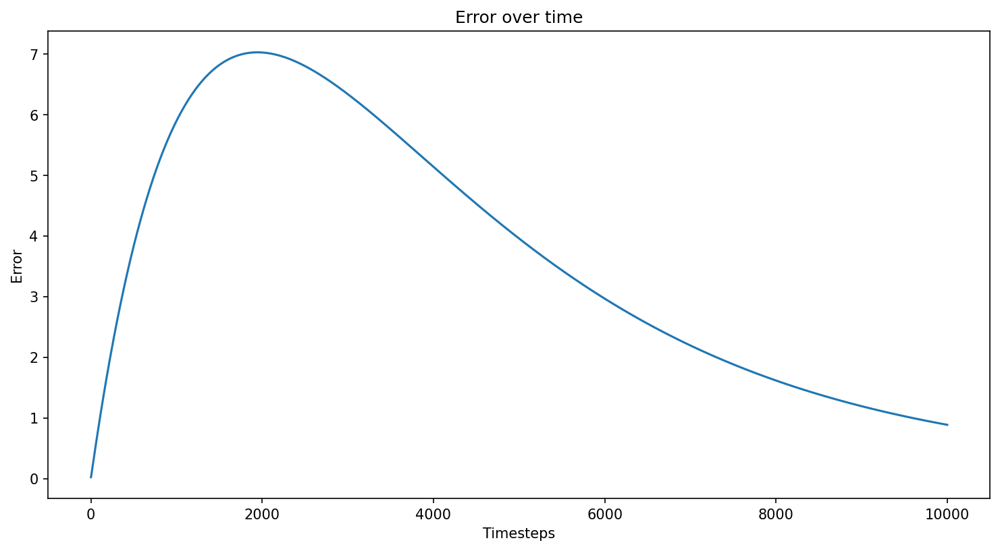

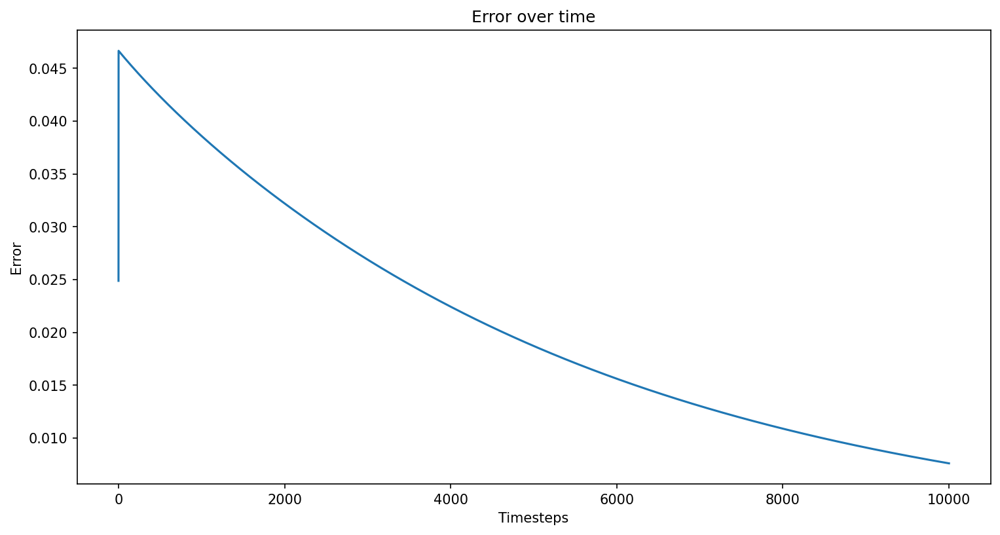

In [1]:
import numpy as np
import numpy.fft as npfft
from muFFT import FFT
from mpi4py import MPI
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['figure.dpi'] = 150
mpl.rcParams['figure.figsize'] = [8, 8]

t = 0
# The assigned size of the mesh
M = 5
# Actual number of nodes in each direction
N = 2**M
# Physical size of computational box
L = 2*np.pi
# The mesh
X = np.mgrid[:N, :N, :N].astype(float)*L/N

nb_grid_pts = (N, N, N)
nx, ny, nz = nb_grid_pts
lx, ly, lz = L, L, L
fft = FFT(nb_grid_pts, engine="mpi", allow_temporary_buffer=True, communicator=MPI.COMM_WORLD)

K = (2 * np.pi * fft.ifftfreq.T / np.array([lx, ly, lz])).T
K2 = np.square(np.linalg.norm(K, axis=0))
KoverK2 = np.divide(K, np.where(K2 == 0, 1.0, K2))

error_data = []
error_du_data = []

U = np.zeros((3, N, N, N))
U[0] = np.cos(X[0]) * np.sin(X[1])
U[1] = -np.sin(X[0]) * np.cos(X[1])

def analytical_solution(t, nu, y):
    return y * np.exp(-2 * nu * t)

def rk4(f, t: float, y: np.ndarray, dt: float) -> np.ndarray:
    """
    Implements the fourth-order Runge-Kutta method for numerical integration
    of multidimensional fields.

    Parameters
    ----------
    f : function
        The function to be integrated. It should take two arguments: time t
        and field y.
    t : float
        The current time.
    y : array_like
        The current value of the field.
    dt : float
        The time step for the integration.

    Returns
    -------
    dy : np.ndarray
        The increment of the field required to obtain the value at t + dt.
    """
    k1 = f(t, y)
    k2 = f(t + dt / 2, y + dt / 2 * k1)
    k3 = f(t + dt / 2, y + dt / 2 * k2)
    k4 = f(t + dt, y + dt * k3)
    return dt * (1/6) * (k1 + (2 * k2) + (2 * k3) + k4)

def Curl3D(u_f_field_p, curl_f_field_p, curl_r_field_p):
    u_x = u_f_field_p[0]
    u_y = u_f_field_p[1]
    u_z = u_f_field_p[2]

    k_x = fft.fftfreq[0]
    k_y = fft.fftfreq[1]
    k_z = fft.fftfreq[2]

    curl_f_field_p[0] = 1j * (k_y * u_z - k_z * u_y)
    curl_f_field_p[1] = 1j * (k_z * u_x - k_x * u_z)
    curl_f_field_p[2] = 1j * (k_x * u_y - k_y * u_x)

    fft.ifft(curl_f_field_p, curl_r_field_p)

def Cross3D(a, b, result_r_field_p, result_f_field_p):

    result_r_field_p[0] = a[1]*b[2] - a[2]*b[1]
    result_r_field_p[1] = a[2]*b[0] - a[0]*b[2]
    result_r_field_p[2] = a[0]*b[1] - a[1]*b[0]

    fft.fft(result_r_field_p, result_f_field_p)

    result_f_field_p[0] *= fft.normalisation
    result_f_field_p[1] *= fft.normalisation
    result_f_field_p[2] *= fft.normalisation

def computeRHS(t, U):

    U_r_field.p[0] = U[0]
    U_r_field.p[1] = U[1]
    U_r_field.p[2] = U[2]

    fft.fft(U_r_field, U_f_field)

    U_f_field.p[0] *= fft.normalisation
    U_f_field.p[1] *= fft.normalisation
    U_f_field.p[2] *= fft.normalisation

    Curl3D(U_f_field.p, Curl_f_field.p, Curl_r_field.p)
    Cross3D(U, Curl_r_field.p, cross_result_r_field.p, cross_result_f_field.p)

    Pressure_f_field.p = cross_result_f_field.p.copy()*KoverK2

    cross_result_f_field.p[0] -= Pressure_f_field.p[0]*K[0]
    cross_result_f_field.p[1] -= Pressure_f_field.p[1]*K[1]
    cross_result_f_field.p[2] -= Pressure_f_field.p[2]*K[2]

    cross_result_f_field.p[0] -= nu*K2*U_f_field.p[0]
    cross_result_f_field.p[1] -= nu*K2*U_f_field.p[1]
    cross_result_f_field.p[2] -= nu*K2*U_f_field.p[2]

    fft.ifft(cross_result_f_field, result_r_field)

    return result_r_field.p.copy()


U_r_field = fft.real_space_field('u_rf', (3,))
U_f_field = fft.fourier_space_field('u_ff', (3,))
cross_result_r_field = fft.real_space_field('cross_result_rf', (3,))
cross_result_f_field = fft.fourier_space_field('cross_result_ff', (3,))
result_r_field = fft.real_space_field('result_rf', (3,))
Pressure_f_field = fft.fourier_space_field('pressure_ff', 3)
Curl_r_field = fft.real_space_field('curl_rf', (3,))
Curl_f_field = fft.fourier_space_field('curl_ff', (3,))


nu = 0.0089 # cm^2/s (1/1600)
maxT = 100
td = 0.01 
maxSteps = int(maxT/td)+1

t = 0
step = 0

U_old = U.copy()
dU_ana = U_old - analytical_solution(t, nu, U_old)
for i in range(maxSteps):

    # dU = computeRHS(t, U) * td
    dU = rk4(computeRHS, t, U, td)#  * td

    if i == 0:
        dU_ana = U_old - analytical_solution(t, nu, U_old)
    else: 
        dU_ana = U_ana - analytical_solution(t, nu, U_old)

    U_ana = analytical_solution(t, nu, U_old)

    du_error = np.linalg.norm(dU - dU_ana)
    error_du_data.append(du_error)
    # print("Error in du: ", du_error)
    # print(dU)
    # input()
    U += dU

    U_ana = analytical_solution(t, nu, U_old)

    # compute error between U_ana and U. U_ana is the analytical solution
    error = np.linalg.norm(U - U_ana)
    error_data.append(error)

    if step % 100 == 0:
        plt.figure(figsize=(12, 6))

        plt.subplot(1, 2, 1)
        plt.title("Analytical Solution")
        plt.quiver(X[0][:,:,0], X[1][:,:,0], U_ana[0][:,:,0], U_ana[1][:,:,0], scale=30)

        plt.subplot(1, 2, 2)
        plt.title("Numerical Solution")
        plt.quiver(X[0][:,:,0], X[1][:,:,0], U[0][:,:,0], U[1][:,:,0], scale=30)


        error = np.linalg.norm(U - U_ana)
        plt.suptitle(f"Timestep: {i}")

        plt.show()

    step += 1
    t += td
    # print(f"Step: {step}, Time: {t}")


plt.figure(figsize=(12, 6))
plt.title("Error over time")
plt.xlabel("Timesteps")
plt.ylabel("Error")
x_range = np.arange(0, len(error_data))
plt.plot(x_range, error_data)
plt.show()

plt.figure(figsize=(12, 6))
plt.title("Error over time")
plt.xlabel("Timesteps")
plt.ylabel("Error")
x_range = np.arange(0, len(error_du_data))
plt.plot(x_range, error_du_data)
plt.show()

# Write error data to file
with open("error_data.txt", "w") as f:
    for error in error_data:
        f.write(f"{error}\n")

with open("error_du_data.txt", "w") as f:
    for error in error_du_data:
        f.write(f"{error}\n")
